Github for all code and supporting notebooks: <a href='https://github.com/pschlais/kaggle_nfl_bdb_2022'>https://github.com/pschlais/kaggle_nfl_bdb_2022</a>

# Introduction

Punts are one of the most volatile plays in football due to the change in possession, high speeds, and large distances covered during the play. From the receiving team's point of view, attempting a return or calling for a fair catch is a split-second decision that can have a large impact on the result of the play. When a return is attempted, the outcome of that risk-reward decision is easy to quantify with multiple metrics: yards gained, possession retained, and player injury. However, it's hard to quantify the outcome of a fair catch with existing metrics because the play has been cut off; the yards that would've been gained if a return was attempted are an opportunity cost for the returning team. From a fan's perspective, determining how "good" or "bad" a fair catch decision is on any given punt is an educated guess at best.

As an example, look at the play below. Was a fair catch a good decision on this play? The catch is at frame 76. If no fair catch was called, the closest defender was a few yards away but closing at high speed, resulting in no return yards and a forceful tackle. However, if that tackle was missed, there was a crease towards the bottom sideline and blockers in the area. 

Without a framework to quantify fair catches, any comparisons or judgments are subjective.

In [1]:
# add local directory to import path
import os
import sys
module_path = os.path.abspath(os.path.join('.'))
if module_path not in sys.path:
    sys.path.append(module_path)

#### --- Standard imports ------
import pickle
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import mean_absolute_error, r2_score

from IPython.display import HTML, display
from matplotlib.colors import LinearSegmentedColormap

# local import
import nflplot
import nflutil
import nfl_bdb22

In [2]:
year = 2020
track_df = pd.read_csv(f'csv/tracking{year}.csv')
play_df = pd.read_csv('csv/plays.csv')
game_df = pd.read_csv('csv/games.csv')
player_df = pd.read_csv('csv/players.csv')
pff_df = pd.read_csv('csv/PFFScoutingData.csv')

In [3]:
game_id = 2020121312
play_id = 2829
playvis = nflplot.PlayAnimation(track_df, play_df, game_df, game_id, play_id)
plt.close()

print(play_df.loc[(play_df.gameId==game_id) & (play_df.playId==play_id), 'playDescription'].iloc[0])

HTML(playvis.animation.to_jshtml())

(8:54) M.Wishnowsky punts 48 yards to WAS 34, Center-T.Pepper, fair catch by S.Sims.


The goal of this analysis is to provide a quantitative basis for evaluating teams and players on their ability to determine when calling for a fair catch is a good decision relative to the risks of attempting a return. Since the severity of risks are subjective, an objective way to rank fair catches against one another is to focus on the reward side of the tradeoff. This analysis quantifies the reward by estimating return yardage if a return was attempted instead of a fair catch, which will be called **Predicted Yards Forfeited (PYF)** for the remainder of this report.

In other words, a fair catch on a play with low Predicted Yards Forfeited is a better decision than a fair catch on a play with high Predicted Yards Forfeited.

# Analysis/Modeling

## Premise for model to predict return yardage on fair catch plays

* Use the state of the game at the moment a fair catch is signaled to predict the return yardage if a fair catch had not been signaled (PYF). This **must** be the prediction point because defender behavior changes beyond this time, due to protections given to the returner by the rule book (e.g. slowing down and/or altering path to avoid contact to avoid a penalty).
* Training a model to predict the eventual return yardage at any point during an actual return will provide coverage and generality for any fair catch play. This can generate PYF for any arbitrary fair catch signal timing during the play.
* Only generating features based on the state of the players without consideration for the teams or individual players provides generality across time, as the general structure and rules of punt plays have not changed substantially in recent years. This allows the model to be applied to fair catches in the past with a very low risk of target leakage.

## Quantifying factors that may influence return yardage

At each frame:
* **Time until the catch**
* **Expected defenders in proximity**: at current distances and speeds of defenders, how many will reach the player? How many within 5, 10, 20 yards?
* **Distance** between defenders and returner
* **Time required by defender to reach the returner** at given speed
* **"Will-Reach Factor"**: Expected distance covered by the defender at current speed compared to the current distance to the returner, normalized by time until the catch. Higher magnitudes mean more certainty that the defender will (or won't) reach the returner and therefore more impact on the play result. As time to catch decreases, certainty increases and this reflects as higher magnitudes due to a decreasing denominator.
* **"Leverage"**: lateral distance between defender and returner. This is a proxy for the returner having space or increased chance to run past the defender, force a poor tackle attempt, or break a tackle.
* **Current speed of the returner**: absolute, lateral, and downfield
* **Distance from the nearest sideline** - how much open space is available to the returner laterally on both sides

Other potential factors that could be investigated but were not included as part of this analysis:
* Weather conditions
* Field/surface type
* "Zones of control" as demonstrated by soccer analytics and past NFL Big Data Bowl projects

### Determining how many defenders to include in per-defender features

Intuition says that the closer a defender is to the returner at the time of the catch, the more likely the defender will be the one who tackles the returner. The tracking data and PFF data contain all of the information needed to confirm this theory, as well as calculate frequencies of what defender makes the tackle, where the defenders are ordered based on their distance from the returner at the time of the catch.

The two plots below are the frequencies and CDF for the relative position of the eventual tackler on the play for the 2020 season.

In [4]:
# limit to punt plays
play_punt_mask = ((play_df['specialTeamsPlayType']=='Punt') & 
                  (play_df['specialTeamsResult']=='Return') &
                  ~play_df['returnerId'].astype(str).str.contains(';')
                 )

rpac_df = (play_df.loc[play_punt_mask, ['gameId','playId','returnerId']]
 .astype({"returnerId": float})
 # attach the returner ID and frame ID of the "punt_received" event to each play
 .merge(nflutil.get_frame_of_event(track_df, 'punt_received'),
        how='inner',
        on=['gameId','playId'])
 # get the returner position on the field when the punt is caught
 .merge(track_df[['gameId','playId','frameId','nflId','team','x','y']],
        how='inner',
        left_on=['gameId','playId','frameId','returnerId'],
        right_on=['gameId','playId','frameId','nflId'])
 .drop(columns=['nflId'])
 .rename(columns={'x':'x_returner', 'y':'y_returner', 'team':'teamReturner'})
 # attach home and away team labels for each game
 .merge(game_df[['gameId','homeTeamAbbr','visitorTeamAbbr']],
        how='inner',
        on='gameId')
 # attach the returner location to each opposing team player's position
 .merge(track_df[['gameId','playId','frameId','nflId','team','jerseyNumber','x','y']],
        how='inner',
        on=['gameId','playId','frameId'])
 .query('teamReturner != team and team != "football"')
 .astype({'jerseyNumber': int})
 # assemble identifier for punting team players
 .assign(puntTeamAbbr=lambda df_: np.where(df_['team']=='home', df_['homeTeamAbbr'], df_['visitorTeamAbbr']),
         jerseyID=lambda df_: df_['puntTeamAbbr'] + ' ' + df_['jerseyNumber'].astype(str).str.rjust(2, '0'))
 .drop(columns=['teamReturner', 'team', 'homeTeamAbbr', 'visitorTeamAbbr'])
 # calculate distance to returner
 .assign(dist=lambda df_: np.sqrt((df_['x']-df_['x_returner'])**2 + (df_['y']-df_['y_returner'])**2))
 # attach distance order within given play
 .sort_values(['gameId','playId','dist'])
 .assign(dist_order=lambda df_: df_.groupby(['gameId','playId']).cumcount()+1)
 # merge with PFF tackler data
 .merge(pff_df[['gameId','playId','tackler','kickContactType']].dropna(subset=['tackler']),
        how='inner',
        left_on=['gameId','playId','jerseyID'],
        right_on=['gameId','playId','tackler'])
 .merge(player_df[['nflId','displayName']],
        how='left',
        on='nflId')
 .query('kickContactType == "CC"')  # air clean catch
)

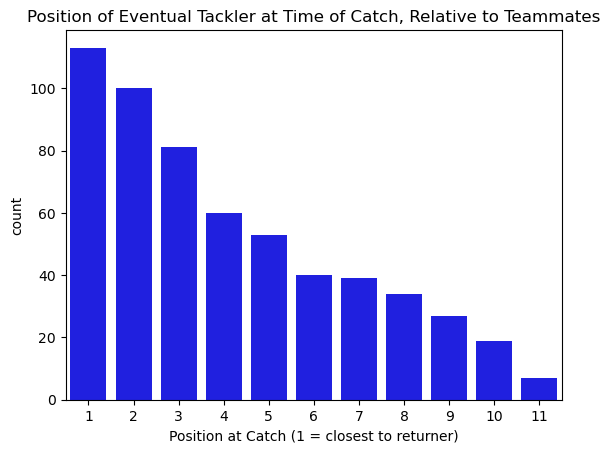

In [5]:
ax = sns.countplot(data=rpac_df, x='dist_order', color='blue')
_ = ax.set(xlabel='Position at Catch (1 = closest to returner)', title="Position of Eventual Tackler at Time of Catch, Relative to Teammates")

As expected, the closer the defender is to the returner relative to the defender's teammates, the more likely the defender is to make the tackle. A closer look at the CDF is needed to determine a suitable cutoff "N" for generating features for the N-closest defenders.

CDF:
dist_order
1     0.197208
2     0.371728
3     0.513089
4     0.617801
5     0.710297
6     0.780105
7     0.848168
8     0.907504
9     0.954625
10    0.987784
11    1.000000
Name: count, dtype: float64


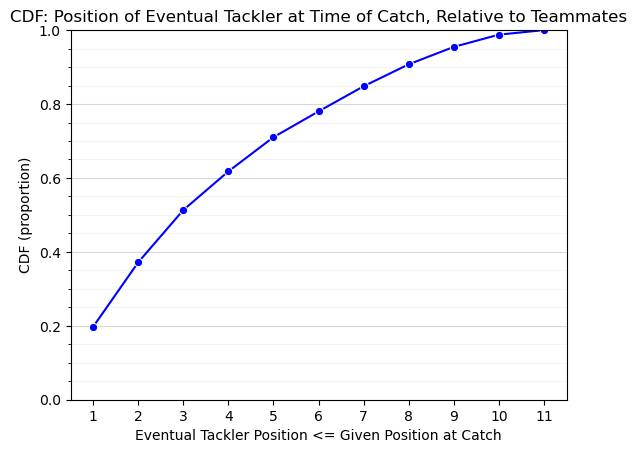

In [6]:
rpac_cdf = rpac_df.dist_order.value_counts().sort_index().cumsum() / len(rpac_df)
print('CDF:')
print(rpac_cdf)
ax = sns.lineplot(x=rpac_cdf.index, y=rpac_cdf.values, marker='o', color='blue')
_ = ax.set(xlabel='Eventual Tackler Position <= Given Position at Catch', title="CDF: Position of Eventual Tackler at Time of Catch, Relative to Teammates",
           ylabel='CDF (proportion)')
ax.set_ylim([0,1])
ax.minorticks_on()
ax.tick_params(axis='x', which='minor', bottom=False)
ax.set_xticks(range(1, np.max(rpac_cdf.index) + 1))
ax.grid(visible=True, which='major', axis='y', alpha=0.5)
ax.grid(visible=True, which='minor', axis='y', alpha=0.15)

For model simplicity, the closest **5** defenders will be used for per-defender features. The closest 5 defenders account for the tackle in 71% of plays. This is half of the players defending (excluding the punter, who trails the play), and even if these 5 players do not make the tackle, it's reasonable to assume they have a major influence on the returner's path, speed, and direction which indirectly determines the outcome of the play.

## Model Training and Evaluation

An XGBoost Regression model is trained on clean-catch punt returns where a return is attempted, for all frames between the punt and the catch, to predict the return yardage based on the game state features during that frame.

To prevent model overfitting/memorization in the train-test split and cross validation, all frames for a given play were grouped together for the purposes of determining the data splits. In other words, a play is exclusively in either the train, cross-validation, or test split at any point in the model fitting process. The tracking data is 10 hertz, so successive frames are highly correlated with each other and would likely overfit the model if frames of the same play were spread across the data splits.

The training set is relevant frames from 2018, 2019, and Weeks 1-8 of 2020, using 5-fold cross validation with play grouping as described above. The test set is relevant frames from Weeks 9-17 of 2020 to simulate the model being applied to future data.

In [7]:
# get data and generated features
game_df = pd.read_csv('csv/games.csv')
play_df = pd.read_csv('csv/plays.csv')
df_features = pd.read_csv('csv/model_features.csv', index_col=0)

# -- split games for train and test -------------------------
# Train = 2018, 2019, and Weeks 1-8 of 2020
# Test = Weeks 9-17 of 2020
weeks = range(9,18)
test_games = game_df.loc[game_df.week.isin(weeks) & (game_df.season==2020), ['gameId','season','week']]
train_games = game_df.loc[~(game_df.week.isin(weeks) & (game_df.season==2020)), ['gameId','season','week']]

# -- TRAIN SET -------------------------------------------
model_df = df_features.loc[df_features.gameId.isin(train_games['gameId']), :]
X_train = model_df.drop(columns='kickReturnYardage')
Y_train = model_df[['gameId','playId','frameId','kickReturnYardage']]

# -- TEST SET --------------------------------------------
model_test_df = df_features.loc[df_features.gameId.isin(test_games.gameId)]
X_test = model_test_df.drop(columns='kickReturnYardage')
Y_test = model_test_df[['gameId', 'playId', 'frameId', 'kickReturnYardage']]

# -- LOAD MODEL (see github notebooks for details) ----------
with open('yd_predict_model.pickle', 'rb') as file:
    model = pickle.load(file)

### Quantitative Performance

In [8]:
# Training set
mae_train = mean_absolute_error(Y_train.kickReturnYardage, model.predict(X=X_train.drop(columns=['gameId','playId','frameId'])))
print('Training set results')
print(f'MAE: {mae_train}')
print()

# Test set
mae_test = mean_absolute_error(Y_test.kickReturnYardage, model.predict(X=X_test.drop(columns=['gameId','playId','frameId'])))
print('Test set results')
print(f'MAE: {mae_test}')
print()

Training set results
MAE: 6.128697182278637

Test set results
MAE: 6.652370838353698



An average error of over 6 yards is not particularly good for predicting return yardage on a single play, given that most returns are under 10 yards. This is not entirely unexpected because: 

***Punt returns are a high-variance play.*** Since punts span roughly 50 yards from the line of scrimmage, players are spread out and the impact of the initial defender making a tackle versus missing a tackle can be the difference between a 25 yard gain and a stop for a loss.

***This model is predicting far into the future.*** The yardage gain on plays are already difficult to predict when a defined player has the ball and every defender is attempting to tackle that player; this observation was the problem statement for the <a href="https://www.kaggle.com/c/nfl-big-data-bowl-2020">2020 Big Data Bowl</a>. Predicting eventual return yardage seconds before the ball gets to the returner adds even more uncertainty about player positioning and speeds that have a big impact on the end result.

Even though the model may not predict the absolute return yardage correctly on a given play, if it captures enough of the signal, it can still be used as a prediction for relative ranking. To investigate this, the actual return yardage in the test set was binned and the predicted yardage for those returns was plotted using a box plot.

In general, looking at the medians in each actual return yardage bin below, an increase in the actual return yardage correlates to an increase in the predicted return yardage. There appears to be enough signal in this model to do a relative analysis.

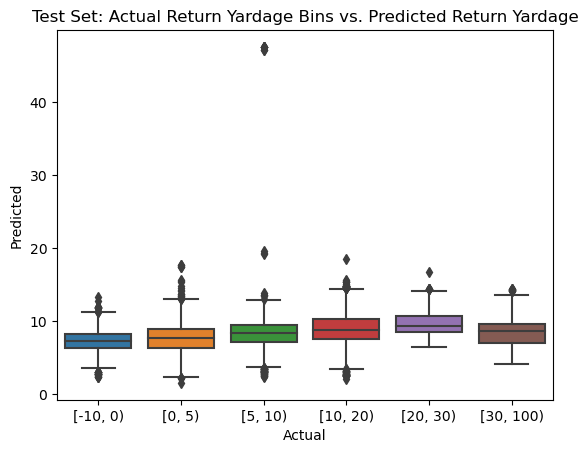

In [9]:
# add predictions and metadata to Test set targets
Y_test_w_pred = Y_test.copy()
Y_test_w_pred['kickReturnYardage_pred'] = model.predict(X=X_test.drop(columns=['gameId','playId','frameId']))
Y_test_w_pred['diff'] = Y_test_w_pred.kickReturnYardage_pred - Y_test_w_pred.kickReturnYardage
Y_test_w_pred['yardGroup'] = pd.cut(Y_test_w_pred.kickReturnYardage, bins=[-10,0,5,10,20,30,100], right=False)
Y_test_w_pred['timeToCatch'] = (
        # catch frame for the play
        Y_test_w_pred.merge(Y_test_w_pred.groupby(['gameId','playId'])['frameId'].max().rename('catch_frame'), how='inner', on=['gameId','playId'])['catch_frame'].to_numpy()
        -
        Y_test_w_pred['frameId'].to_numpy()
) / 10 # convert to seconds

# create boxplot of actual return yardage bins vs. predicted return yardage
_, ax = plt.subplots()
sns.boxplot(data=Y_test_w_pred, x='yardGroup',y='kickReturnYardage_pred', ax=ax)
ax.set_title('Test Set: Actual Return Yardage Bins vs. Predicted Return Yardage')
ax.set_ylabel('Predicted')
ax.set_xlabel('Actual');

### Qualitative Performance

Visualizing the tracking data for the largest and smallest predictions on ***fair catch*** plays (i.e. Predicted Yards Forfeited - PYF) during the 2020 season can give an indication if the model is worthwhile to use as the basis for a relative ranking.

The trained model is applied to the frame where the returner signals for a fair catch to generate PYF for that decision. In this dataset, the fair catch signal event is not labeled; the "fair_catch" event identifier is the actual catch. For the purpose of model demonstration, the fair catch signal frame is assumed to be **1.5 seconds (15 frames)** before the catch on all fair catch plays. This event could be labeled in future datasets to more accurately select the proper frame for a play.

In [10]:
# -- generate features for fair catch plays, and downselect to "fair catch signal" frames ----------------------
n_defenders = 5
years = [2020]
dfs = []
for year in years:
    track_df = nflutil.transform_tracking_data(pd.read_csv(f'csv/tracking{year}.csv'))

    temp_feature_df = (
        nfl_bdb22.prep_get_modeling_frames(track_df, 
                                    play_df=play_df, 
                                    pff_df=pff_df, 
                                    play_end_event_name='fair_catch'
                                    )
        .pipe(nfl_bdb22.model_create_features, play_df=play_df, game_df=game_df, n_defenders=n_defenders, catch_type='fair_catch')
        .query('timeToCatch==1.5')
    )
    dfs.append(temp_feature_df)

# turn into single dataframe (if multiple years were transformed)
feature_df = pd.concat(dfs)

# -- add predictions ------------------------------------------------------------
predict_df = (
                feature_df[['gameId','playId','frameId']]
                .assign(pry_pred=model.predict(X=feature_df.drop(columns=['gameId','playId','frameId'])))
                .reset_index(drop=True)
            )

# -- get base dataframe for punt returns --------------------------------------------
puntreturn_df = (
    predict_df
    # get returner nflId
    .merge(play_df[['gameId','playId','possessionTeam','returnerId']],
           how='inner',
           on=['gameId', 'playId'])
    .assign(returnerId=lambda df_: pd.to_numeric(df_.returnerId))
    # get team information
    .merge(game_df[['gameId','homeTeamAbbr','visitorTeamAbbr','season','week']],
           how='inner',
           on=['gameId'])
    # set the returning team - the opposite of the possesion team (defined as the one kicking/punting the ball)
    .assign(receivingTeam=lambda df_: np.where(df_.possessionTeam==df_.homeTeamAbbr, df_.visitorTeamAbbr, df_.homeTeamAbbr))
    .drop(columns=['homeTeamAbbr', 'visitorTeamAbbr'])
    # add returner name
    .merge(player_df[['nflId', 'displayName']],
           how='left',
           left_on='returnerId',
           right_on='nflId')
    .drop(columns='returnerId')
)

puntreturn_df.sort_values('pry_pred', ascending=False)

,gameId,playId,frameId,pry_pred,possessionTeam,season,week,receivingTeam,nflId,displayName
174,2020112902,3007,62,11.388199,CIN,2020,12,NYG,44837,Jabrill Peppers
470,2020092013,3886,59,11.113464,SEA,2020,2,NE,42899,Damiere Byrd
30,2021010315,386,65,11.003078,SEA,2020,17,SF,45900,River Cracraft
94,2020122013,3832,60,10.853280,SF,2020,15,DAL,52425,CeeDee Lamb
184,2020112908,529,61,10.687877,NO,2020,12,DEN,42935,Bryce Callahan
...,...,...,...,...,...,...,...,...,...,...
231,2020112300,1802,64,1.663075,TB,2020,11,LA,48784,Nsimba Webster
388,2020100402,2475,74,1.614278,JAX,2020,4,CIN,43663,Alex Erickson
55,2020122707,3725,63,1.414185,CHI,2020,16,JAX,52631,Chris Claybrooks
62,2020122710,2965,62,1.357717,CAR,2020,16,WAS,48051,Steven Sims


#### High predicted return yardage on fair catch

Looking at the highest predicted value on a fair catch by Jabrill Peppers (gameId = 2020112902, play = 3007, PYF = 11.4 yards), from a visual perspective this is a very poor fair catch decision. Assuming a fair catch signal at frame 62, the ball is ahead of the closest gunner (Wilson, FS #40) and the ball will clearly arrive before the gunner arrives. Beyond Wilson, there is no other defender close by. Peppers has the option to go towards the bottom sideline to make the first gunner miss a tackle, or run angled towards the wide open field.

If a return was attempted on this play, there was an opportunity for a big return, with a high floor of a few yard gain. This fair catch was a poor decision, and the model aligns with that assessment.

In [11]:
game_id = 2020112902
play_id = 3007
playvis = nflplot.PlayAnimation(track_df, play_df, game_df, game_id, play_id)
plt.close()

print(play_df.loc[(play_df.gameId==game_id) & (play_df.playId==play_id), 'playDescription'].iloc[0])

HTML(playvis.animation.to_jshtml())

(9:46) K.Huber punts 57 yards to NYG 20, Center-C.Harris, fair catch by J.Peppers.


#### Low predicted return yardage on fair catch

Looking at the lowest predicted value on a fair catch by Jakeem Grant (gameId = 2020110106, play = 2722, PYF = 1.2 yards), from a visual perspective this appears to be a good fair catch decision. Assuming a fair catch signal at frame 68, Grant has identified this as a short punt relative to where he lined up to receive it, and he is running forward to get into position to catch the ball. The closest gunner (Jefferson, WR #12) is clearly going to arrive before the ball reaches Grant, which increases the likelihood of an immediate tackle, or a big hit in an unprotected position with a fumble or an injury. Beyond Jefferson, the other Rams defenders are closing in so there will be multiple defenders in position to tackle.

If a return was attempted on this play, there was very little opportunity for a big return, with a high likelihood of a poor return result. This fair catch was a good decision, and the model aligns with that assessment.

In [12]:
game_id = 2020110106
play_id = 2722
playvis = nflplot.PlayAnimation(track_df, play_df, game_df, game_id, play_id)
plt.close()

print(play_df.loc[(play_df.gameId==game_id) & (play_df.playId==play_id), 'playDescription'].iloc[0])

HTML(playvis.animation.to_jshtml())

(11:13) J.Hekker punts 44 yards to MIA 31, Center-J.McQuaide, fair catch by J.Grant. MIA-P.Laird was injured during the play. His return is Probable.


# Results

The model can be used to compare performance of teams and individual returners at a season level by looking at their PYF per fair catch (PYF/FC), simply the average PYF over all fair catches. The results use the 2020 season as an example.

## Team Performance

In [13]:
# --- get punt return performance by team ---------------------------------------------
# punt plays with return yardage
play_filter = (play_df.specialTeamsPlayType=='Punt') & (play_df.specialTeamsResult=='Return') & (~play_df.kickReturnYardage.isna()) & (play_df.gameId.astype(str).str[:4].astype(int).isin(years))

prbyteam_actual_df = (
    play_df.loc[play_filter, ['gameId','playId','possessionTeam','kickReturnYardage']]
    # get team information
    .merge(game_df[['gameId','homeTeamAbbr','visitorTeamAbbr','season','week']],
           how='inner',
           on=['gameId'])
    # set the returning team - the opposite of the possesion team (defined as the one kicking/punting the ball)
    .assign(receivingTeam=lambda df_: np.where(df_.possessionTeam==df_.homeTeamAbbr, df_.visitorTeamAbbr, df_.homeTeamAbbr))
    .drop(columns=['homeTeamAbbr', 'visitorTeamAbbr'])
    .groupby('receivingTeam')['kickReturnYardage']
    .aggregate(['count','mean'])
    .reset_index()
    .rename(columns={'mean':'mean_returnyardage', 'count':'returns'})
)

# --- add Predicted Yards Forfeited (PYF) and team colors to dataframe ------------------
team_colors = {abbr: c['main'] for abbr, c in nflutil.TEAM_COLORS.items()}
team_color_df = pd.DataFrame(zip(team_colors.keys(), team_colors.values()), columns=['teamAbbr','teamColor'])

prbyteam_df = (
    # get predicted yards by team
    puntreturn_df.groupby('receivingTeam')['pry_pred'].agg(['count','mean']).sort_values('mean', ascending=False).reset_index().rename(columns={'mean':'mean_faircatchlost'})
    # attach actual yards by team
    .merge(prbyteam_actual_df,
           how='inner',
           on='receivingTeam')
    # add colors for each team
    .merge(team_color_df,
           how='inner',
           left_on='receivingTeam',
           right_on='teamAbbr')
    .sort_values('mean_faircatchlost', ascending=True)
    )

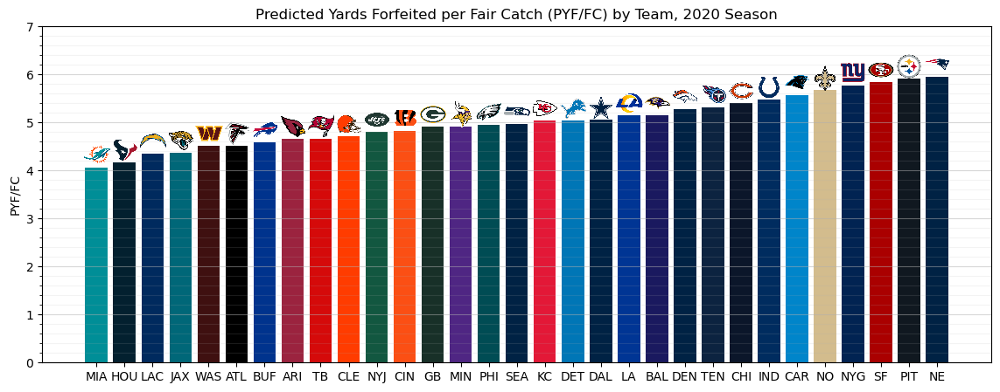

In [14]:
#create figure
f, ax = plt.subplots(figsize=(14,5))
# create bar plot
ax = nflplot.create_team_bar_plot(ax, prbyteam_df['teamAbbr'], prbyteam_df['mean_faircatchlost'])
# set labels and grid
ax.set_ylabel('PYF/FC')
ax.set_ylim([0, 7])
ax.set_title('Predicted Yards Forfeited per Fair Catch (PYF/FC) by Team, 2020 Season')
ax.minorticks_on()
ax.tick_params(axis='x', which='minor', bottom=False)
ax.grid(visible=True, which='major', axis='y', alpha=0.5)
ax.grid(visible=True, which='minor', axis='y', alpha=0.15)

Based on the chart above, special teams units can be ranked against each other to see where each team ranks in the quality of fair catch decision-making. After calculating the PYF/FC for each team for the 2020 season, the 5 best teams are:
* Miami Dolphins
* Houston Texans
* Los Angeles Chargers
* Jacksonville Jaguars
* Washington Commanders (name was Football Team in 2020)

The 5 worst teams are:
* Carolina Panthers
* New York Giants
* San Francisco 49ers
* Pittsburgh Steelers
* New England Patriots

Decision-making can also be explored in 2 dimensions, both for return decisions and fair catch decisions. The ideal team would have a high punt return average and low PYF/FC. This comparison is shown in the plot below.

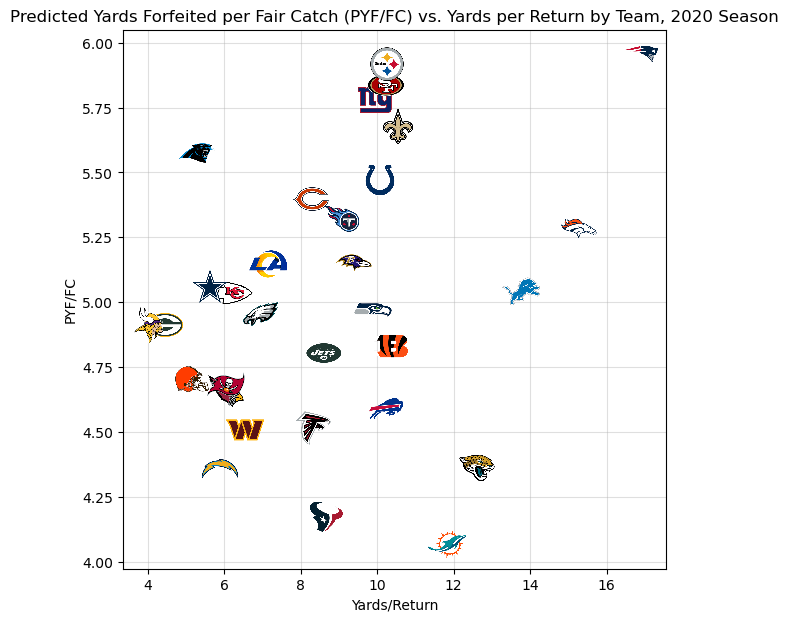

In [15]:
#create figure
f, ax = plt.subplots(figsize=(7,7))
# create scatter plot
ax = nflplot.create_team_scatter_plot(ax=ax, x=prbyteam_df['mean_returnyardage'], y=prbyteam_df['mean_faircatchlost'], team_labels=prbyteam_df['teamAbbr'])
# set labels and grid
ax.set_xlabel('Yards/Return')
ax.set_ylabel('PYF/FC')
ax.set_title('Predicted Yards Forfeited per Fair Catch (PYF/FC) vs. Yards per Return by Team, 2020 Season')
ax.grid(visible=True, which='major', axis='both', alpha=0.4)

The best decision making is in the bottom right: high yards per return and low PYF/FC. The worst decision making is in the top left: low yards per return and high PYF/FC. A few observations:
* MIA is far to the bottom right, which means great decisions in both returns and fair catches. They are 1st in PYF/FC and is 5th in yards per return.
* NE is the worst in PYF/FC, but they also have the highest return average. They are very good at returning when they elect to return, so they may benefit from being less conservative about signaling for a fair catch.
* CAR is near the bottom in PYF/FC and also near the bottom in return average. Their decision making and return ability needs improvement to catch up to the rest of the league.


## Individual Returners

The same analysis can be applied to individual returners. To remove small sample sizes, the minimum threshold for inclusion is 8 fair catches over the course of the season. This equates to about one fair catch per two games.

In [16]:
# set the minimum number of attempts
min_faircatch_threshold = 8  # minimum ~1 fair catch per 2 games average

# get relevant player predicted fair catch data
player_analysis_df = (
    puntreturn_df
    .groupby('displayName')
     .filter(lambda x: x.displayName.count() >= min_faircatch_threshold)
)

# punt plays with return yardage
play_filter = (play_df.specialTeamsPlayType=='Punt') & (play_df.specialTeamsResult=='Return') & (~play_df.kickReturnYardage.isna()) & (~play_df.returnerId.astype(str).str.contains(';') & (play_df.gameId.astype(str).str[:4].astype(int).isin(years)))

# add actual return performance per player
player_means = (
    player_analysis_df.groupby(['displayName','nflId'])['pry_pred'].agg(['count','mean']).sort_values('mean', ascending=True).reset_index()
    .merge(
        (
            play_df.loc[play_filter, ['returnerId','kickReturnYardage']]
            .assign(returnerId=lambda df_: pd.to_numeric(df_.returnerId))
            .rename(columns={'returnerId': 'nflId'})
            .groupby('nflId')['kickReturnYardage'].aggregate(['count','mean'])
        ),
        how='left',
        on='nflId'
    )
    .rename(columns={'count_x': 'fairCatches', 'mean_x': 'PYFperFC', 'count_y': 'returns', 'mean_y': 'yardsPerReturn'})
)

player_means.style.background_gradient(cmap='viridis', subset=['PYFperFC', 'yardsPerReturn'])

,displayName,nflId,fairCatches,PYFperFC,returns,yardsPerReturn
0,Jakeem Grant,43475,8,4.068155,27,12.222222
1,Jaydon Mickens,44029,12,4.177959,14,6.571429
2,Steven Sims,48051,17,4.222257,17,7.529412
3,K.J. Hill,52628,8,4.460328,11,7.545455
4,Cooper Kupp,44881,10,4.593028,8,5.625000
5,Brandon Powell,46830,19,4.618690,13,8.307692
6,Andre Roberts,35527,11,4.688098,27,10.592593
7,Braxton Berrios,46279,22,4.782713,10,8.600000
8,David Moore,45039,13,4.803611,10,10.500000
9,Alex Erickson,43663,19,4.830363,19,10.368421


A few observations from the individual returner statistics:
* **Jakeem Grant** (who was the returner on the lowest PYF play) had a great season for fair catches and returns. He has the lowest PYF/FC and is near the top for Yards per Return.
* **Jabrill Peppers** (who was the returner on the highest PYF play) did not have a good season for fair catches and returns. He has the 2nd highest PYF/FC and is in the bottom half of Yards per Return.
* **Gunner Olszewski** and **Diontae Spencer** were both explosive returners with the highest Yards per Return, but were in the bottom half of PYF/FC. Their fair catch decision making could be developed further to become premier punt returners.
* **Pharoh Cooper** (CAR) is near the bottom on PYF/FC and last in Yards per Return. The Panthers may want to consider making a change at punt returner due to his poor performance in both aspects of returning.

# Conclusion

Predicted Yards Forfeited (PYF) provides a relative metric to evaluate fair catch quality on individual plays and at an aggregate level. There are a few applications for this metric listed here:

* **Team-level special teams unit evaluation**: fair catch plays can be quantified and performance evaluated at a unit level, both as the returning unit and the punting unit
* **Player evaluation**: fair catch performance as another factor for roster construction or determining the depth chart
* **Enhanced TV viewer experience**: if the player data collection and processing is near-real time, the resulting fair catch and PYF value could be classified into a bin based historical quantiles to give a general indication on the quality of the decision (poor, good, excellent, etc.). This would be similar to using Next-Gen stats in current TV broadcasts.